In [2]:
import pandas as pd

In [3]:
df = pd.read_csv("../dataset/clean_dataset.csv").dropna().reset_index(drop=True)

df

,X_LOC,Y_LOC,DEPT,NPHI,DTC,SP,RHOB,GR,CALI,Lithology_code,Cluster_DBSCAN
0,455221.34375,6533321.5,2712.460002,0.218318,71.954613,115.249199,2.257217,58.311520,14.666450,30000.0,0.0
1,455221.34375,6533321.5,2726.596002,0.085455,59.167652,107.675835,2.548615,88.030212,12.509160,30000.0,0.0
2,455221.34375,6533321.5,2726.748002,0.114017,60.975471,106.604393,2.518298,86.302811,12.547709,30000.0,0.0
3,455221.34375,6533321.5,2726.900002,0.147875,62.972198,105.224342,2.492360,79.648369,12.620093,30000.0,0.0
4,455221.34375,6533321.5,2727.052002,0.180865,64.157539,103.775002,2.470284,67.485962,12.537360,30000.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
250254,475882.21875,6621553.0,2238.192000,0.358785,112.132500,85.751999,2.327521,44.279440,13.171748,99000.0,9.0
250255,475882.21875,6621553.0,2238.344000,0.355681,111.552429,86.463982,2.340207,46.894100,13.179663,99000.0,9.0
250256,475882.21875,6621553.0,2238.496000,0.352395,110.810074,88.444344,2.352964,45.771843,13.399187,99000.0,9.0
250257,475882.21875,6621553.0,2238.648000,0.322448,109.873856,90.435295,2.382930,42.283649,13.746966,99000.0,9.0


In [4]:
main_column = ["GR", "NPHI", "RHOB", "DTC"]

In [5]:
main_dataset = df[main_column]

## Check Correlation Heatmap

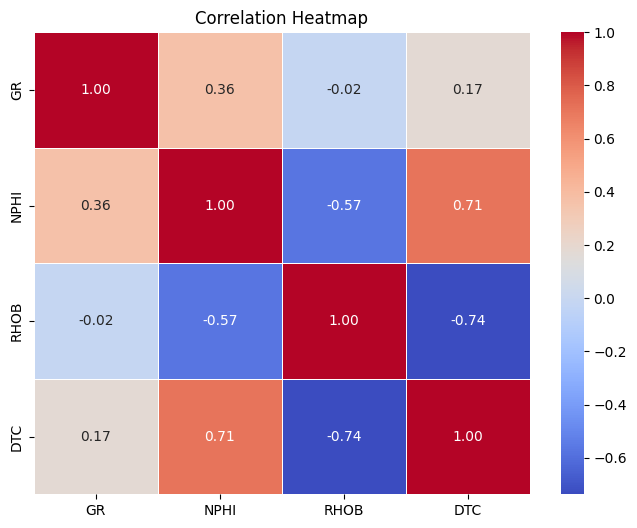

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(8, 6))
sns.heatmap(main_dataset.corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

## PCA

In [7]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np

In [8]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(main_dataset)

df_scaled

array([[-0.05952726, -1.09813368,  0.18148104, -1.6006609 ],
       [ 0.97516118, -2.02870415,  1.33293213, -2.02281842],
       [ 0.91501982, -1.82865387,  1.21313406, -1.96313382],
       ...,
       [-0.49610967, -0.15905492,  0.55982193, -0.31785997],
       [-0.6175549 , -0.36880714,  0.67823322, -0.34876893],
       [-0.65143903, -0.37020117,  0.71493669, -0.32976392]])

In [9]:
pca = PCA(n_components=4)
data_pca = pca.fit_transform(df_scaled)

In [10]:
var_exp = pca.explained_variance_ratio_
cum_var_exp = np.cumsum(var_exp)

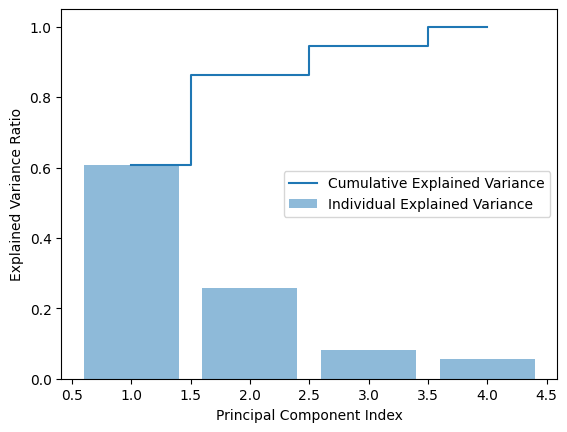

In [11]:
plt.bar(range(1, len(var_exp) + 1), var_exp, alpha=0.5, align='center',
        label='Individual Explained Variance')
plt.step(range(1, len(cum_var_exp) + 1), cum_var_exp, where='mid',
         label='Cumulative Explained Variance')

plt.ylabel('Explained Variance Ratio')
plt.xlabel('Principal Component Index')
plt.legend(loc='best')
plt.show()

## PC = 2

In [12]:
pca = PCA(n_components=2)
df_pca = pd.DataFrame(pca.fit_transform(df_scaled), 
                      columns=['PC1', 'PC2'])

df_pca

,PC1,PC2
0,-1.671970,0.088927
1,-2.831631,1.368243
2,-2.632750,1.291828
3,-2.456580,1.072066
4,-2.350343,0.688275
...,...,...
250254,-0.592863,-0.298983
250255,-0.622964,-0.198740
250256,-0.685990,-0.215069
250257,-0.913059,-0.308893


In [13]:
df_pca['Label'] = df['Lithology_code']

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


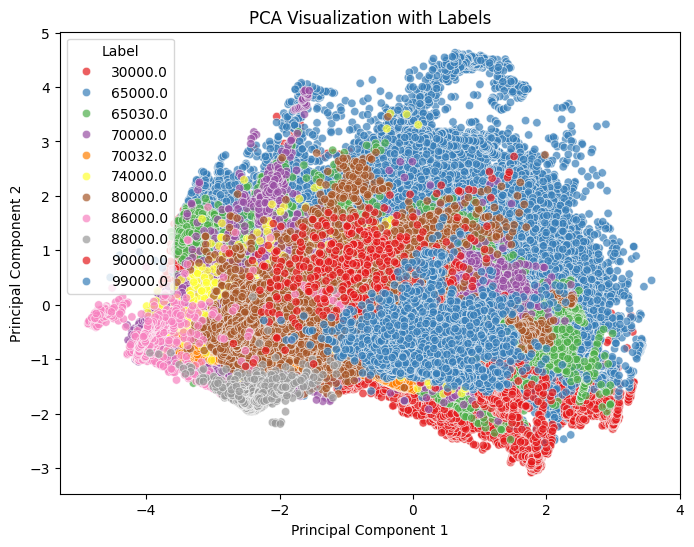

In [14]:
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.scatterplot(x=df_pca['PC1'], y=df_pca['PC2'], hue=df_pca['Label'], palette='Set1', alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA Visualization with Labels')
plt.legend(title='Label')
plt.show()

## PC = 3

In [15]:
pca = PCA(n_components=3)
df_pca = pd.DataFrame(pca.fit_transform(df_scaled), 
                      columns=['PC1', 'PC2', 'PC3'])

df_pca

,PC1,PC2,PC3
0,-1.671970,0.088927,-0.659700
1,-2.831631,1.368243,-1.007795
2,-2.632750,1.291828,-0.916242
3,-2.456580,1.072066,-0.724424
4,-2.350343,0.688275,-0.456861
...,...,...,...
250254,-0.592863,-0.298983,0.397272
250255,-0.622964,-0.198740,0.378299
250256,-0.685990,-0.215069,0.406765
250257,-0.913059,-0.308893,0.375158


In [16]:
df_pca['Label'] = df['Lithology_code'].astype(int).astype(str)

In [17]:
df_pca['Label'].isna().sum()

0

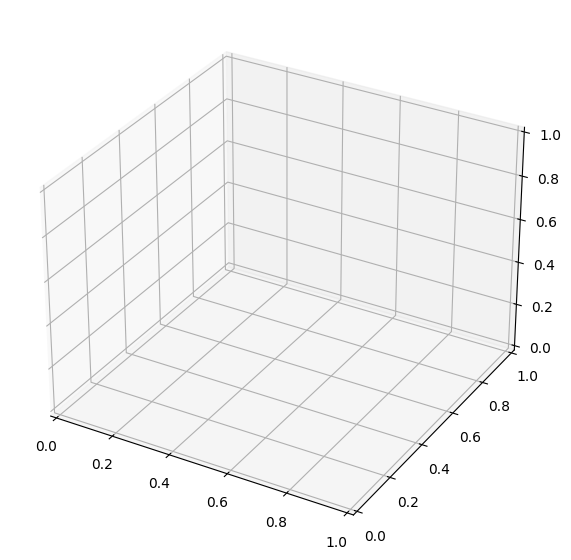

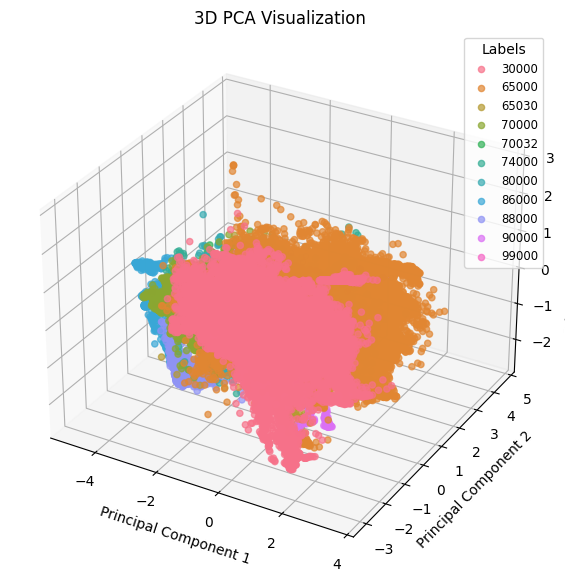

In [18]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create 3D plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Define colors for each label
# Generate unique colors using Seaborn palette
unique_labels = df_pca['Label'].unique()
colors = sns.color_palette("husl", len(unique_labels))  # Generate distinct colors
color_map = dict(zip(unique_labels, colors))  # Map labels to colors

# Create 3D figure
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for each label
for label in unique_labels:
    subset = df_pca[df_pca['Label'] == label]
    ax.scatter(subset['PC1'], subset['PC2'], subset['PC3'], 
               color=[color_map[label]], label=label, alpha=0.7)

# Labels & title
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D PCA Visualization')

# Show legend
ax.legend(loc='best', fontsize='small', title='Labels')

plt.show()



In [19]:
import plotly.express as px
import pandas as pd

# Replace NaN values in labels  # Convert labels to string

# Create interactive 3D scatter plot
fig = px.scatter_3d(
    df_pca, 
    x='PC1', y='PC2', z='PC3', 
    color='Label',  # Color by label
    title='Interactive 3D PCA Visualization',
    opacity=0.8
)

# Show the figure
fig.show()


## Model Machine Learning

In [20]:
df_pca

,PC1,PC2,PC3,Label
0,-1.671970,0.088927,-0.659700,30000
1,-2.831631,1.368243,-1.007795,30000
2,-2.632750,1.291828,-0.916242,30000
3,-2.456580,1.072066,-0.724424,30000
4,-2.350343,0.688275,-0.456861,30000
...,...,...,...,...
250254,-0.592863,-0.298983,0.397272,99000
250255,-0.622964,-0.198740,0.378299,99000
250256,-0.685990,-0.215069,0.406765,99000
250257,-0.913059,-0.308893,0.375158,99000


In [21]:
from sklearn.model_selection import train_test_split

In [22]:
df_pca.isna().sum()

PC1      0
PC2      0
PC3      0
Label    0
dtype: int64

In [23]:
X, y = df_pca[["PC1", "PC2", "PC3"]], df_pca["Label"]

In [24]:
y.isna().sum()

0

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [26]:
y_train.isna().sum()

0

In [27]:
y_test.isna().sum()

0

In [28]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report

In [29]:
models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "KNN": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier()
}

In [30]:
y_train.isna().sum()

0

In [ ]:
# Train and evaluate
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    print(f"Model: {name}")
    
    print(classification_report(y_test, y_pred))

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Model: Logistic Regression


/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

       30000       0.53      0.46      0.49      8674
       65000       0.74      0.96      0.83     28993
       65030       0.00      0.00      0.00      4143
       70000       0.53      0.63      0.57      3312
       70032       0.00      0.00      0.00      1126
       74000       0.00      0.00      0.00       228
       80000       0.00      0.00      0.00      1606
       86000       0.86      0.66      0.75       207
       88000       0.95      0.98      0.97       795
       90000       0.00      0.00      0.00       205
       99000       0.00      0.00      0.00       763

    accuracy                           0.69     50052
   macro avg       0.33      0.33      0.33     50052
weighted avg       0.57      0.69      0.62     50052

Model: Random Forest
              precision    recall  f1-score   support

       30000       0.81      0.82      0.82      8674
       65000       0.88      0.95      0.91     28993
   